# 第8章 ニューラルネットワーク・ディープラーニングの応用～手書き数字の認識～（1）
## 8.1 MNISTデータベース

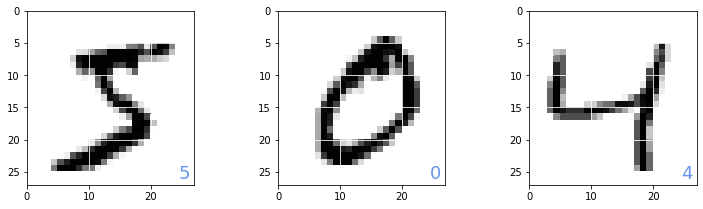

In [8]:
# リスト 8-1-(1)
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.datasets import mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()

# リスト 8-1-(2)
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(1, figsize=(12, 3.2))
plt.subplots_adjust(wspace=0.5)
plt.gray()
for id in range(3):
    plt.subplot(1, 3, id + 1)
    img = x_train[id, :, :]
    plt.pcolor(255 - img)
    plt.text(24.5, 26, '%d' % y_train[id], color='cornflowerblue', fontsize=18)
    plt.xlim(0, 27)
    plt.ylim(27, 0)
    plt.grid('on', color='white')
plt.show()

## 8.2 2層フィードフォワードネットワークモデル 

In [9]:
# リスト 8-1-(3)
from tensorflow.keras.utils import to_categorical   # tf.kerasにnp_utilsはない

x_train = x_train.reshape(60000, 784)
x_train = x_train.astype('float32')
x_train = x_train / 255
num_classes = 10
y_train = to_categorical(y_train, num_classes)

x_test = x_test.reshape(10000, 784)
x_test = x_test.astype('float32')
x_test = x_test / 255
y_test = to_categorical(y_test, num_classes)

# リスト 8-1-(4)
np.random.seed(1)
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import Adam

model = Sequential()
model.add(Dense(16, input_dim=784, activation='sigmoid'))
model.add(Dense(10, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])

# リスト 8-1-(5)
import time

startTime = time.time()
history = model.fit(x_train, y_train, epochs=10, batch_size=1000, verbose=1, validation_data=(x_test, y_test))
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss : ', score[0])
print('Test accuracy : ', score[1])
print('Computation time : {0:.3f} sec'.format(time.time() - startTime))

Train on 60000 samples, validate on 10000 samples
Epoch 1/10
60000/60000 [==============================] - 0s 8us/sample - loss: 2.0830 - accuracy: 0.3127 - val_loss: 1.8288 - val_accuracy: 0.5205
Epoch 2/10
60000/60000 [==============================] - 0s 3us/sample - loss: 1.6671 - accuracy: 0.6076 - val_loss: 1.5030 - val_accuracy: 0.7110
Epoch 3/10
60000/60000 [==============================] - 0s 3us/sample - loss: 1.3844 - accuracy: 0.7729 - val_loss: 1.2510 - val_accuracy: 0.8127
Epoch 4/10
60000/60000 [==============================] - 0s 3us/sample - loss: 1.1618 - accuracy: 0.8187 - val_loss: 1.0536 - val_accuracy: 0.8418
Epoch 5/10
60000/60000 [==============================] - 0s 3us/sample - loss: 0.9864 - accuracy: 0.8440 - val_loss: 0.8985 - val_accuracy: 0.8606
Epoch 6/10
60000/60000 [==============================] - 0s 4us/sample - loss: 0.8490 - accuracy: 0.8607 - val_loss: 0.7787 - val_accuracy: 0.8742
Epoch 7/10
60000/60000 [==============================] - 0s 3

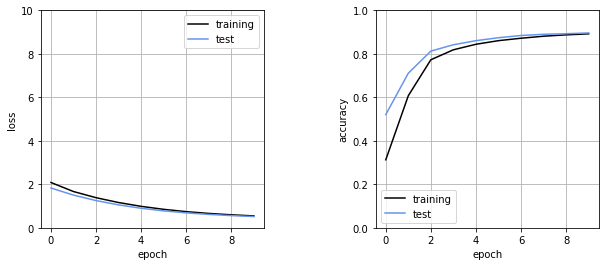

In [11]:
# リスト 8-1-(6)
plt.figure(1, figsize=(10, 4))
plt.subplots_adjust(wspace=0.5)

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='training', color='black')
plt.plot(history.history['val_loss'], label='test', color='cornflowerblue')
plt.ylim(0, 10)
plt.legend()
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='training', color='black')
plt.plot(history.history['val_accuracy'], label='test', color='cornflowerblue')
plt.ylim(0, 1)
plt.legend()
plt.grid()
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.show()

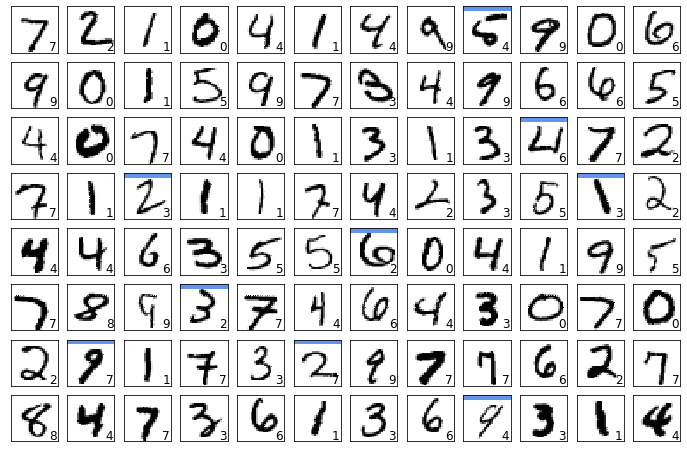

In [12]:
# リスト 8-1-(7)
def show_prediction():
    n_show = 96
    y = model.predict(x_test)
    plt.figure(2, figsize=(12, 8))
    plt.gray()
    for i in range(n_show):
        plt.subplot(8, 12, i + 1)
        x = x_test[i, :]
        x = x.reshape(28, 28)
        plt.pcolor(1 - x)
        wk = y[i, :]
        prediction = np.argmax(wk)
        plt.text(22, 25.5, '%d' % prediction, fontsize=12)
        if prediction != np.argmax(y_test[i, :]):
            plt.plot([0, 27], [1, 1], color='cornflowerblue', linewidth=5)
        plt.xlim(0, 27)
        plt.ylim(27, 0)
        plt.xticks([], '')
        plt.yticks([], '')

show_prediction()
plt.show()

## 8.3 ReLU活性化関数

In [13]:
# リスト 8-1-(8)
np.random.seed(1)

model = Sequential()
model.add(Dense(16, input_dim=784, activation='relu'))
model.add(Dense(10, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])

startTime = time.time()
history = model.fit(x_train, y_train, epochs=10, batch_size=1000, verbose=1, validation_data=(x_test, y_test))
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss : ', score[0])
print('Test accuracy : ', score[1])
print('Computation time : {0:.3f} sec'.format(time.time() - startTime))

Train on 60000 samples, validate on 10000 samples
Epoch 1/10
60000/60000 [==============================] - 1s 9us/sample - loss: 1.4526 - accuracy: 0.6058 - val_loss: 0.8295 - val_accuracy: 0.8261
Epoch 2/10
60000/60000 [==============================] - 0s 4us/sample - loss: 0.6411 - accuracy: 0.8494 - val_loss: 0.4959 - val_accuracy: 0.8778
Epoch 3/10
60000/60000 [==============================] - 0s 4us/sample - loss: 0.4540 - accuracy: 0.8811 - val_loss: 0.3963 - val_accuracy: 0.8987
Epoch 4/10
60000/60000 [==============================] - 0s 4us/sample - loss: 0.3813 - accuracy: 0.8968 - val_loss: 0.3489 - val_accuracy: 0.9073
Epoch 5/10
60000/60000 [==============================] - 0s 4us/sample - loss: 0.3417 - accuracy: 0.9064 - val_loss: 0.3204 - val_accuracy: 0.9146
Epoch 6/10
60000/60000 [==============================] - 0s 4us/sample - loss: 0.3167 - accuracy: 0.9120 - val_loss: 0.3030 - val_accuracy: 0.9162
Epoch 7/10
60000/60000 [==============================] - 0s 4

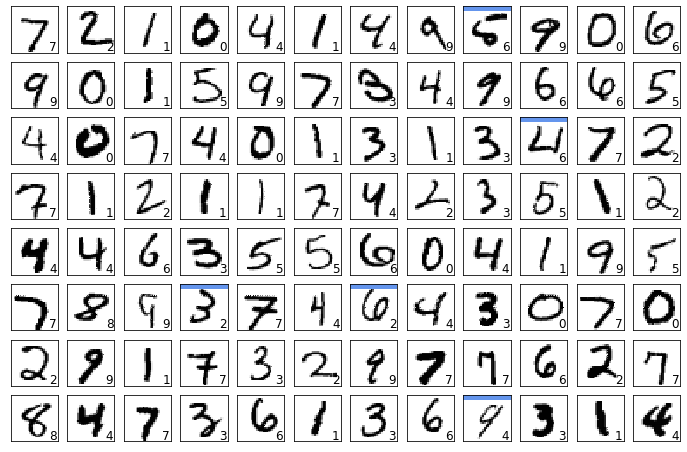

In [14]:
# リスト 8-1-(9)
show_prediction()
plt.show()

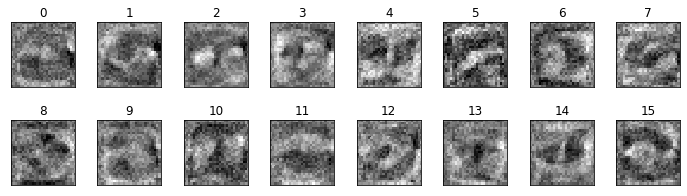

In [16]:
# リスト 8-1-(10)
# 1層目の重みの視覚化
w = model.layers[0].get_weights()[0]
plt.figure(1, figsize=(12, 3))
plt.gray()
plt.subplots_adjust(wspace=0.35, hspace=0.5)
for i in range(16):
    plt.subplot(2, 8, i + 1)
    w1 = w[:, i]
    w1 = w1.reshape(28, 28)
    plt.pcolor(-w1)
    plt.xlim(0, 27)
    plt.ylim(27, 0)
    plt.xticks([], '')
    plt.yticks([], '')
    plt.title('%d' % i)
plt.show()